## Извлекаем фичи из рядов и мерджим с фичами по дням и сезонам

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
import matplotlib.pyplot as plt
from collections import namedtuple 

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
sns.set()

In [2]:
date = namedtuple('Date', 'month day')

In [57]:
#Функция вычисления центроидов всех кластеров 
def centroids(data, clusters):
    n = np.unique(clusters)
    dist_mean = []
    for i in n:
        matrix = data[clusters == i]
        dist_mean.append(np.mean(matrix, axis=0))
    return np.array(dist_mean)

#Расстояние между цетроидами кластеров (на вход матрица цетроидов) 
def cluster_dist(matrix):
    size = matrix.shape[0]
    av_dist = [sum((euclid(matrix[i], matrix[j]) for j in range(i, size))) for i in range(size)]
    return sum(av_dist)/ len(av_dist)

#Функция вычисления среднего расстояния между кластерами  
av_dist = lambda df, cl: cluster_dist(centroids(df, cl))

#Евклидово расстояние
euclid = lambda x, y: np.sqrt(np.sum((x - y)**2))

def plot(*args):
    plt.figure(figsize=(20, 6))
    for arg in args:
        plt.plot(arg.T)
    plt.title('Data Example')
    plt.show()

    
s1 = [pd.datetime(2017, 9, 1), pd.datetime(2018, 9, 1)]
d31 = [pd.datetime(2017, 12, 31), pd.datetime(2018, 12, 31)]
f14 = [pd.datetime(2018, 2, 14), pd.datetime(2019, 2, 14)]
f23 = [pd.datetime(2018, 2, 23), pd.datetime(2019, 2, 23)]
m8 = [pd.datetime(2018, 3, 8), pd.datetime(2019, 3, 8)]
allhol = [s1, d31, f14, f23, m8]
colors = ['b', 'g', 'r', 'm', 'c']    

def save_clust(data, clusters, model, lines=100):
    centroid = centroids(data, clusters)
    n = np.unique(clusters)
    fig = plt.figure(figsize=(20, 400))
    for i in n:
        plt.subplot(len(n), 1, i+1)
        plt.title(f'cluster {i}, {clusters[clusters==i].count()} items')
        for j, color in zip(allhol, colors):
            plt.axvline(j[0], c=color, label=j[0])
            plt.axvline(j[1], c=color, label=j[1])
        idx = np.where(clusters == i)[0][:lines]
        plt.plot(data.columns, centroid[i], c='red')
        for j in idx:
            plt.plot(data.T.iloc[:, j], c='black', alpha=0.05)
    plt.savefig(fname=f'results/{model}.png', bbox_inches='tight')
    plt.close(fig)

def plot_clust(data, clusters, lines=100):
    centroid = centroids(data, clusters)
    n = np.unique(clusters)
    fig = plt.figure(figsize=(20, 500), dpi=90)
    for i in n:
        plt.subplot(len(n), 1, i+1)
        plt.title(f'cluster {i}, {clusters[clusters==i].count()} items')
        for j, color in zip(allhol, colors):
            line1 = plt.axvline(j[0], c=color, label=str(j[0]))
            th1 = plt.text(j[0],
                           0.8,
                           f'{j[0].date()}',
                           verticalalignment='center',
                           rotation=90,
                           rotation_mode='anchor',
                           horizontalalignment='center',
                           fontsize=14,
                          va="baseline")

            line2 = plt.axvline(j[1], c=color, label=str(j[1]))
            th2 = plt.text(j[1],
                       0.8,
                       f'{j[1].date()}',
                       verticalalignment='center',
                       rotation=90,
                       rotation_mode='anchor',
                       horizontalalignment='center',
                       fontsize=14,
                      va="baseline")
#             plt.xticks(rotation=-45)
        idx = np.where(clusters == i)[0][:lines]
        l1 = plt.plot(data.columns, centroid[i], c='red', alpha=2, label='mean')
        for j in idx:
            plt.plot(data.T.iloc[:, j], c='black', alpha=0.03) 
            
def metrics_values(data, clusters):
    metrics = {
                'Average Distance': av_dist(data, clusters),
#                 'Silhouette score': silhouette_score(data, clusters),
#                 'Calinski-Harabasz score': calinski_harabasz_score(data, clusters),
                'Davies bouldin score': davies_bouldin_score(data, clusters)
    }
    return metrics
    

# Extract dates

In [4]:
df = pd.read_csv(r'st_ts.txt', index_col='id')
df = np.log(1.1 + df).T
df.index = pd.DatetimeIndex(df.index).T
scale = StandardScaler()
sc_df = pd.DataFrame(scale.fit_transform(df).T, index=df.columns, columns=df.index)

In [5]:
seasons = {
    'winter': [12, 1, 2],
    'spring': [3, 4, 5],
    'summer': [6, 7, 8],
    'fall': [9, 10, 11]
}

dates = {
    '31d': date(12, 31),
    '1s': date(9, 1),
    '14f': date(2, 14),
    '23f': date(2, 23),
    '8m': date(3, 8)
}

In [6]:
def extract_dates_by_years(df, celeb, year, n_days):
    date = pd.datetime(year=year, month=dates[celeb].month, day=dates[celeb].day)
    sum1 = df[df.index <= date][-n_days:].sum()
    sum2 = df[df.index > date][:n_days].sum()
    return sum1 / sum2

def extract_seasons(df, season1, season2):
    sum1 = df[df.index.month.isin(seasons[season1])].sum()
    sum2 = df[df.index.month.isin(seasons[season2])].sum()
    return sum1 / sum2

def extract_seasons_by_years(df, year, season1, season2):
    if season1 == 'winter':
        sum1 = df[(df.index.month.isin(seasons[season1]))  & (df.index.year.isin([year, year-1])) & (df.index < f'{year}-03-01')].sum()
        sum2 = df[(df.index.month.isin(seasons[season2]))  & (df.index.year == year)].sum()
        return sum1 / sum2
    if season2 == 'winter':
        sum1 = df[(df.index.month.isin(seasons[season1]))  & (df.index.year == year)].sum()
        sum2 = df[(df.index.month.isin(seasons[season2]))  & (df.index.year.isin([year, year-1])) & (df.index < f'{year}-03-01')].sum()
        return sum1 / sum2
    sum1 = df[(df.index.month.isin(seasons[season1]))  & (df.index.year == year)].sum()
    sum2 = df[(df.index.month.isin(seasons[season2]))  & (df.index.year == year)].sum()
    return sum1 / sum2

def month_by_year(df: pd.core.frame, year: str, month: int):
    df_temp = df[year]
    month_weight = df_temp[df_temp.index.month == month].sum()
    year_weight = df_temp.sum()
    return month_weight.values / year_weight.values

In [7]:
day_feat = [extract_seasons(df, 'winter', 'summer'), extract_seasons(df, 'winter', 'spring'),
            extract_seasons(df, 'winter', 'fall'),
            extract_seasons(df, 'summer', 'spring'), extract_seasons(df, 'summer', 'fall'),
            extract_seasons(df, 'fall', 'spring'),
            extract_seasons(df, 'spring', 'winter'), extract_seasons(df, 'spring', 'fall'), 
            extract_seasons(df, 'summer', 'winter'), 
            extract_dates_by_years(df, '31d', 2017, 2), extract_dates_by_years(df, '31d', 2017, 3),
            extract_dates_by_years(df, '31d', 2018, 2), extract_dates_by_years(df, '31d', 2018, 3),
            extract_dates_by_years(df, '1s', 2017, 1), extract_dates_by_years(df, '1s', 2017, 2),
            extract_dates_by_years(df, '1s', 2018, 2),
            extract_dates_by_years(df, '1s', 2018, 3), extract_dates_by_years(df, '1s', 2018, 4),
            extract_dates_by_years(df, '14f', 2018, 1), extract_dates_by_years(df, '14f', 2019, 1),
            extract_dates_by_years(df, '23f', 2018, 1), extract_dates_by_years(df, '23f', 2019, 1),
            extract_dates_by_years(df, '8m', 2018, 1), extract_dates_by_years(df, '8m', 2019, 1)]



In [8]:
df_dates = pd.DataFrame(day_feat).T
df_dates = pd.DataFrame(scale.fit_transform(df_dates), index=df_dates.index)

# Extract features by tsfresh

In [9]:
from tsfresh.feature_extraction import feature_calculators
from tsfresh.feature_extraction import extract_features, MinimalFCParameters
from tsfresh.utilities.distribution import MultiprocessingDistributor
from tsfresh.utilities.dataframe_functions import roll_time_series
from tsfresh import extract_relevant_features

In [10]:
fresh_df = pd.read_csv(r'fresh_format.csv', index_col='Unnamed: 0')
fresh_df1 = pd.read_csv(r'fresh_format1.csv', index_col='Unnamed: 0')
fresh_df2 = pd.read_csv(r'fresh_format2.csv', index_col='Unnamed: 0')

/opt/conda/lib/python3.7/site-packages/numpy/lib/arraysetops.py:569: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [11]:
fresh_df1.shape,  fresh_df2.shape, fresh_df.shape

((16835832, 3), (16835832, 3), (33995430, 3))

In [12]:
fresh_df['time'] = pd.to_datetime(fresh_df['time'])
fresh_df1['time'] = pd.to_datetime(fresh_df1['time'])
fresh_df2['time'] = pd.to_datetime(fresh_df2['time'])

In [13]:
# fresh_df = fresh_df[:105 * 60000]
# fresh_df1 = fresh_df1[:52 * 60000]
# fresh_df2 = fresh_df2[:52 * 60000]

In [32]:
fc_param = {
    'autocorrelation': [{'lag': 1}],

            
}

In [33]:
fc_param1 = {
    'linear_trend': [{'attr': 'slope'}, {'attr': 'intercept'}],
    'skewness': None,
    'kurtosis': None,
    'fft_coefficient': [{'coeff':3, 'attr': 'abs'}, {'coeff':3, 'attr': 'angle'},\
                        {'coeff':2, 'attr': 'abs'}, {'coeff':2, 'attr': 'angle'},\
                        {'coeff':1, 'attr': 'abs'}, {'coeff':1, 'attr': 'angle'},],
}

In [34]:
X = extract_features(fresh_df, column_id='id', column_sort='time',\
                  default_fc_parameters=fc_param1)

X1 = extract_features(fresh_df1, column_id='id', column_sort='time',\
                  default_fc_parameters=fc_param)

X2 = extract_features(fresh_df2, column_id='id', column_sort='time',\
                  default_fc_parameters=fc_param)

Feature Extraction: 100%|██████████| 20/20 [00:35<00:00,  1.79s/it]


In [40]:
df_feats = pd.DataFrame(scale.fit_transform(X), index=X.index, columns=X.columns)

In [41]:
df_feats

variable,"value__fft_coefficient__coeff_1__attr_""abs""","value__fft_coefficient__coeff_1__attr_""angle""","value__fft_coefficient__coeff_2__attr_""abs""","value__fft_coefficient__coeff_2__attr_""angle""","value__fft_coefficient__coeff_3__attr_""abs""","value__fft_coefficient__coeff_3__attr_""angle""",value__kurtosis,"value__linear_trend__attr_""intercept""","value__linear_trend__attr_""slope""",value__skewness
id,,,,,,,,,,
0,-0.635354,1.002294,-0.940018,0.871584,-0.392719,-1.703874,-0.493467,0.193288,-0.193288,-0.849750
1,-0.562389,0.858787,-1.031574,-1.673405,-1.729148,1.608077,-0.425380,0.017026,-0.017026,-0.454582
2,-0.445076,-1.801690,-0.499832,-1.026313,-0.774139,-0.050359,-0.409835,0.854584,-0.854584,-0.258439
3,-1.314033,-0.881173,-0.436477,-0.789374,-1.584252,-0.868855,0.831440,0.940236,-0.940236,1.124489
4,0.828479,-0.038010,1.177661,0.299448,1.545988,0.261372,-0.111175,-0.702770,0.702770,0.386014
...,...,...,...,...,...,...,...,...,...,...
188978573109,-0.354215,-1.484679,0.095427,0.371411,0.176591,-0.897643,-0.196450,0.937191,-0.937191,0.316024
188978573110,-1.194697,-1.512811,-1.221657,-0.687627,-0.296862,-0.850426,0.674267,0.766755,-0.766755,1.138126
188978573111,-0.406413,-0.935717,-0.897086,-0.477484,-0.181504,-1.069143,0.473997,1.264085,-1.264085,0.976670


# Merge

In [42]:
features = df_dates.join(df_feats)

In [44]:
features.head()

,0,1,2,3,4,5,6,7,8,9,...,"value__fft_coefficient__coeff_1__attr_""abs""","value__fft_coefficient__coeff_1__attr_""angle""","value__fft_coefficient__coeff_2__attr_""abs""","value__fft_coefficient__coeff_2__attr_""angle""","value__fft_coefficient__coeff_3__attr_""abs""","value__fft_coefficient__coeff_3__attr_""angle""",value__kurtosis,"value__linear_trend__attr_""intercept""","value__linear_trend__attr_""slope""",value__skewness
id,,,,,,,,,,,,,,,,,,,,,
0,-0.219621,-0.140388,-0.132394,-0.109783,-0.184198,-0.220631,-0.232844,-0.215006,-0.208694,0.169134,...,-0.635354,1.002294,-0.940018,0.871584,-0.392719,-1.703874,-0.493467,0.193288,-0.193288,-0.849750
1,-0.100139,-0.547788,-0.515709,-0.703985,-0.526699,-0.268814,0.268427,-0.166045,-0.308276,-0.384871,...,-0.562389,0.858787,-1.031574,-1.673405,-1.729148,1.608077,-0.425380,0.017026,-0.017026,-0.454582
2,0.574418,0.493376,-0.215718,-0.351990,-0.679357,0.355551,-0.675041,-0.612780,-0.673770,-0.657152,...,-0.445076,-1.801690,-0.499832,-1.026313,-0.774139,-0.050359,-0.409835,0.854584,-0.854584,-0.258439
3,1.543580,2.708319,-0.038048,0.279026,-0.866933,1.815518,-1.267528,-1.018400,-0.932363,-0.384871,...,-1.314033,-0.881173,-0.436477,-0.789374,-1.584252,-0.868855,0.831440,0.940236,-0.940236,1.124489
4,-1.198594,0.218375,-0.740300,5.207287,1.150737,0.834301,-0.515484,-0.799583,2.412959,-0.384871,...,0.828479,-0.038010,1.177661,0.299448,1.545988,0.261372,-0.111175,-0.702770,0.702770,0.386014


# Clustering

1     15002
38    14051
34    12784
46    11197
5     10558
10    10509
11    10489
31    10348
12     9852
4      9631
26     9547
41     9128
9      8661
19     8599
44     8434
22     8252
37     7985
2      7689
18     7520
6      7113
17     6812
24     6651
20     6178
49     6035
23     5910
39     5905
43     5673
33     5544
25     5221
16     5153
36     4674
7      4604
32     4523
14     4509
3      4382
21     4362
8      4058
42     4038
0      3814
40     3611
28     3554
29     3445
35     3272
47     3132
30     2889
45     2302
48     2236
27     1847
13     1668
15      415
dtype: int64


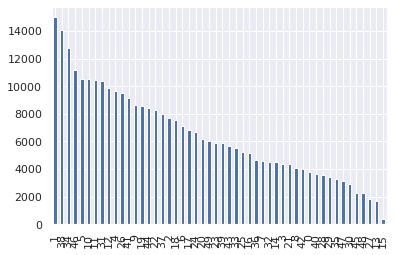

CPU times: user 779 ms, sys: 512 ms, total: 1.29 s
Wall time: 1min 32s


In [45]:
%%time
clusters = pd.Series(KMeans(n_clusters=50, random_state=42, n_jobs = -1).fit_predict(features), index = features.index)

print(clusters.value_counts())
clusters.value_counts().plot.bar()
plt.show()

In [58]:
%%time
plot_clust(sc_df, clusters, 100)

CPU times: user 26.6 s, sys: 8.62 s, total: 35.2 s
Wall time: 22.2 s


In [29]:
print(metrics_values(sc_df, clusters))

{'Average Distance': 100.18966171431892, 'Davies bouldin score': 8.539529850059704}
